# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
from sklearn.compose import make_column_selector as selector
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import lime.lime_tabular
import shap
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from SyntheticDataset import SyntheticDataset
from DatasetAnalysis import DatasetAnalysis
from PerformanceAnalysis import PerformanceAnalysis
from Visualization import Visualization

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup

In [2]:
config_file = open('config.json')
config_vars = json.load(config_file)
config_file.close()

logs_dir = config_vars["logs_dir"] + "/synth_multi"

In [3]:
config_file = open('visual_config.json')
config_vars = json.load(config_file)
config_file.close()

shap_colors_neg = config_vars["shap_colors"]["negative"]
shap_colors_pos = config_vars["shap_colors"]["positive"]
shap_colors = np.array([tuple(shap_colors_neg), tuple(shap_colors_pos)])

title_size = config_vars["title_font_size"]
label_size = config_vars["labels_font_size"]

green_color = tuple([x/255 for x in config_vars["green_colors"]["c2"]])

# Get Dataset

In [4]:
min_val = -100
max_val = 100
num_rows = 1500
num_features = 10
num_classes = 10
rand_coef_class = 0.05
rand_coef = []
for i in range(num_features):
    coef = [0.9 for x in range(num_classes)]
    coef[i % num_classes] = rand_coef_class
    rand_coef.append(coef)

# Each variable contributes to one class, the one with the same number (e.g. Var0 -> Class 0, Var1 -> Class 1)

std_dev = np.array([1.5 - (0.1 * i) for i in range(num_features)])
class_sep = np.ones(10) * 0.5

features_names = ["Var" + (str(x)) for x in range(num_features)]
dataset = SyntheticDataset(min_val, max_val, num_rows, num_features, num_classes, rand_coef, seed=42)
#dataset = SyntheticDataset(min_val, max_val, num_rows, num_features, num_classes, norm_dist=True, seed=42, std_dev_perc=std_dev, class_sep_perc=class_sep)
dataset.generate()
dataset.get_data()

array([[-100.        ,  -12.22431205,   71.71958398, ...,  -74.37727346,
          -9.92281242,    0.        ],
       [-100.        ,   28.77302402,   64.55232265, ...,   26.33287982,
          51.61754802,    0.        ],
       [-100.        ,   78.62422426,   55.67669941, ...,   48.95243118,
          93.50194649,    0.        ],
       ...,
       [  97.41105581,  100.        ,  -44.83053703, ...,   56.62899915,
         100.        ,    9.        ],
       [  48.27427608,  -27.06113521,  100.        , ...,   23.96410892,
         100.        ,    9.        ],
       [ -24.90312501,   -7.89939685,  100.        , ...,   58.71803567,
         100.        ,    9.        ]])

In [5]:
# print([x for x in class_sep])

In [6]:
X = pd.DataFrame(dataset.get_x(), columns=features_names)
y = dataset.get_y()

In [7]:
rand_coef

[[0.05, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.05, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.05, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.05, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.05, 0.9, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.9, 0.05, 0.9, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.05, 0.9, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.05, 0.9, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.05, 0.9],
 [0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.05]]

In [8]:
# fig, ax = plt.subplots(2, 5, figsize=(15, 6))
# ax = ax.flatten()
# 
# cont = 0
# for x in ax:
#     
#     x.hist(X.iloc[:, cont], bins=50, color=green_color)
#     x.set_title(f"Var{cont}")
#     cont += 1
# 
# plt.show()

###### Obtain Dataset From Repository

The only categorical column is 'ID' which has no relevance for classification because is just an identifier of each experiment, so it will be dropped

In [9]:
sss_nsplits = 10
sss = StratifiedShuffleSplit(n_splits=sss_nsplits, test_size=0.2)


lr_clfs = []
lr_limes = []
lr_shaps = []
rf_clfs = []
rf_limes = []
rf_shaps = []
svm_clfs = []
svm_limes = []
svm_shaps = []
ebm_clfs = []

In [10]:
X_trains_pd = []
X_tests_pd = []
Y_trains = []
Y_tests = []
for i, (train_index, test_index) in enumerate(sss.split(X, y)):
    print(len(train_index), len(test_index))
    print(train_index, test_index)
    X_trains_pd.append(X.iloc[train_index])
    X_tests_pd.append(X.iloc[test_index])
    Y_trains.append(y[train_index])
    Y_tests.append(y[test_index])

# X_train = X_train_pd.to_numpy()
# X_test = X_test_pd.to_numpy()

1200 300
[ 692  226  929 ... 1082 1155  559] [ 351  964  775  101 1426 1476 1116  484  782  531 1396  750 1023  415
  621  797  912 1072  936  762  378  886 1113  961  143 1128  460 1462
  419  175  914 1360   99 1318 1257 1075  574  939  941  902 1342  835
  537  113  618  475  276 1080  787 1158 1435 1097  726 1354  224   14
 1498  372  274  130  250  110  803 1274 1496 1306  197 1358  218  685
 1045  211  825 1451 1127  628  443  260  511  204 1259 1380  331  985
  667  575  827 1144  636 1091  963  716 1204   81 1382  213  736  321
  909  381  859  212  482  715  329  504  945 1409 1117  312  624  465
   56  681 1470  977  177  644 1464  450 1040 1230  937   36 1004 1239
  520  279 1137   68  491   33  111  892  400  582  919 1457  232 1196
 1148  243  114  278  590 1427  405 1013 1123  201  924 1085 1363  686
  867  813  991  781 1309  860  875 1270  120  117  142  458  585  498
   45  433  360 1069  866  556  980 1062 1447   82 1079  528 1346  453
  798  150  207  305 1120  515 1

## Instance to extract local explanations for all models

In [11]:
Exp_index = 3
# Exp_inst = X_test[Exp_index, :]
# Exp_inst_pd = X_test_pd.iloc[Exp_index, :]
# Exp_inst_class = Y_test[Exp_index]
# print(f"Instance:\n{Exp_inst_pd}\n\nClass: {Exp_inst_class}") #"Name" and "dtype" are not part of the instance, they must be ignored

# Classification

In [12]:
perf_analysis = PerformanceAnalysis()

## <i>Logistic Regression</i> (LR)

In [13]:
for i in range(sss_nsplits):
    lr_clf = LogisticRegression(solver="lbfgs", max_iter=1000, C=0.01, random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    lr_clfs.append(lr_clf)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the doc

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [14]:
for i in range(sss_nsplits):
    lr_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    lr_limes.append(lr_LIME_explainer)
#lr_LIME_explanation = lr_LIME_explainer.explain_instance(Exp_inst, lr_clf.predict_proba)

In [15]:
#lr_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [16]:
shap.initjs()

In [17]:
for i in range(sss_nsplits):
    lr_SHAP_exp = shap.KernelExplainer(lr_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    lr_shaps.append(lr_SHAP_exp)
#lr_shap_loc_values = np.array(lr_SHAP_exp.shap_values(Exp_inst_pd))

In [18]:
#shap.force_plot(lr_SHAP_exp.expected_value[1], lr_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [19]:
#lr_shap_global_values = lr_SHAP_exp.shap_values(X_test_pd)

In [20]:
#shap.summary_plot(lr_shap_global_values, X_test_pd, plot_type="bar")

## <i>Random Forest</i> (RF)

In [21]:
for i in range(sss_nsplits):
    rf_clf = RandomForestClassifier(n_estimators=1000, bootstrap=False, max_features="sqrt", random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    rf_clfs.append(rf_clf)

In [22]:
# rf_ye = rf_clf.predict(X_test)
# 
# rf_cm = confusion_matrix(Y_test, rf_ye)
# rf_metrics = perf_analysis.compute_metrics(rf_cm)
# display(rf_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, rf_ye)
# 
# rf_y2d = rf_clf.predict_proba(X_test)[:, 1]
# 
# plt.show()

### Extract Explanations 

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [23]:
for i in range(sss_nsplits):
    rf_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    rf_limes.append(rf_LIME_explainer)
#rf_LIME_explanation = rf_LIME_explainer.explain_instance(Exp_inst, rf_clf.predict_proba)

In [24]:
#rf_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [25]:
for i in range(sss_nsplits):
    rf_SHAP_exp = shap.Explainer(rf_clfs[i])
    rf_shaps.append(rf_SHAP_exp)
#rf_shap_loc_values = np.array(rf_SHAP_exp.shap_values(Exp_inst_pd))

In [26]:
#shap.force_plot(rf_SHAP_exp.expected_value[1], rf_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [27]:
#rf_shap_global_values = rf_SHAP_exp.shap_values(X_test_pd)

In [28]:
#shap.summary_plot(rf_shap_global_values, X_test_pd, plot_type="bar")

## <i> Support Vector Machines</i> (SVM)

In [29]:
for i in range(sss_nsplits):
    svm_clf = SVC(kernel="rbf", C=1, cache_size=1000, decision_function_shape="ovo", gamma="scale", probability=True, random_state=42).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    svm_clfs.append(svm_clf)

In [30]:
# svm_ye = svm_clf.predict(X_test)
# 
# svm_cm = confusion_matrix(Y_test, svm_ye)
# svm_metrics = perf_analysis.compute_metrics(svm_cm)
# display(svm_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, svm_ye)
# 
# svm_y2d = svm_clf.decision_function(X_test)
# 
# plt.show()

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [31]:
# svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=features_names)
# svm_LIME_explanation = svm_LIME_explainer.explain_instance(Exp_inst, svm_clf.predict_proba)

In [32]:
for i in range(sss_nsplits):
    svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    svm_limes.append(svm_LIME_explainer)

In [33]:
#svm_LIME_explanation.show_in_notebook(show_table=True)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [34]:
for i in range(sss_nsplits):
    svm_SHAP_exp = shap.KernelExplainer(svm_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    svm_shaps.append(svm_SHAP_exp)
#svm_shap_loc_values = np.array(svm_SHAP_exp.shap_values(Exp_inst_pd))

In [35]:
#shap.force_plot(svm_SHAP_exp.expected_value[1], svm_shap_loc_values[1, :], Exp_inst_pd)

#### Global (SHAP)

In [36]:
#svm_shap_global_values = svm_SHAP_exp.shap_values(X_test_pd)

In [37]:
#shap.summary_plot(svm_shap_global_values, X_test_pd, plot_type="bar")

## <i>Explainable Boosting Machine</i> (EBM)

In [38]:
for i in range(sss_nsplits):
    print(i)
    ebm_clf = ExplainableBoostingClassifier(max_bins=1024, smoothing_rounds=500, cyclic_progress=0, interactions=0, random_state=42).fit(X_trains_pd[i], Y_trains[i])
    ebm_clfs.append(ebm_clf)

0
1
2
3
4
5
6
7
8
9


In [39]:
# ebm_ye = ebm_clf.predict(X_test_pd)
# 
# ebm_cm = confusion_matrix(Y_test, ebm_ye)
# ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
# display(ebm_metrics)
# 
# ConfusionMatrixDisplay.from_predictions(Y_test, ebm_ye)
# 
# ebm_y2d = ebm_clf.decision_function(X_test)
# 
# plt.show()

### Extract Explanations

#### Local

In [40]:
# ebm_local = ebm_clf.explain_local(X_test, Y_test)
# show(ebm_local)

#### Global

In [41]:
# ebm_global = ebm_clf.explain_global()
# show(ebm_global)

# Summary

In [42]:
visual = Visualization()

## Metrics

In [43]:
lr_cms = []
rf_cms = []
svm_cms = []
ebm_cms = []

lr_metrics_lst = []
rf_metrics_lst = []
svm_metrics_lst = []
ebm_metrics_lst = []

for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    lr_cm = confusion_matrix(Y_tests[i], lr_ye)
    
    lr_metrics = perf_analysis.acc_for_class(lr_cm)
    lr_metrics = lr_metrics.rename(columns={0: "LR"})
    lr_metrics["LR"] = [round(x, 2) for x in lr_metrics["LR"]]
    lr_metrics_lst.append(lr_metrics)
    lr_cms.append(lr_cm)
    
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_cm = confusion_matrix(Y_tests[i], rf_ye)
    rf_metrics = perf_analysis.acc_for_class(rf_cm)
    rf_metrics = rf_metrics.rename(columns={0: "RF"})
    rf_metrics["RF"] = [round(x, 2) for x in rf_metrics["RF"]]
    rf_metrics_lst.append(rf_metrics)
    rf_cms.append(rf_cm)

    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_cm = confusion_matrix(Y_tests[i], svm_ye)
    svm_metrics = perf_analysis.acc_for_class(svm_cm)
    svm_metrics = svm_metrics.rename(columns={0: "SVM"})
    svm_metrics["SVM"] = [round(x, 2) for x in svm_metrics["SVM"]]
    svm_metrics_lst.append(svm_metrics)
    svm_cms.append(svm_cm)

    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_cm = confusion_matrix(Y_tests[i], ebm_ye)
    ebm_metrics = perf_analysis.acc_for_class(ebm_cm)
    ebm_metrics = ebm_metrics.rename(columns={0: "EBM"})
    ebm_metrics["EBM"] = [round(x, 2) for x in ebm_metrics["EBM"]]
    ebm_metrics_lst.append(ebm_metrics)
    ebm_cms.append(ebm_cm)

    overall_metrics = pd.concat([lr_metrics, rf_metrics, svm_metrics, ebm_metrics], axis=1)
    display(overall_metrics)

Classes,LR,RF,SVM,EBM
0,0.97,0.93,0.87,0.97
1,0.60,0.97,0.63,0.93
2,0.47,0.97,0.37,1.00
3,0.13,0.90,0.13,0.97
4,0.00,0.90,0.17,0.97
5,0.07,0.90,0.17,0.90
6,0.10,0.93,0.20,1.00
7,0.27,0.90,0.40,0.93
8,0.57,0.87,0.50,0.90
9,0.97,0.97,0.83,0.97


Classes,LR,RF,SVM,EBM
0,0.97,0.93,0.90,0.97
1,0.70,0.93,0.53,0.97
2,0.60,0.90,0.53,0.97
3,0.13,0.90,0.30,1.00
4,0.17,0.93,0.23,1.00
5,0.10,0.90,0.00,1.00
6,0.17,0.90,0.30,0.93
7,0.33,1.00,0.43,1.00
8,0.47,0.93,0.53,0.97
9,0.93,0.97,0.87,0.93


Classes,LR,RF,SVM,EBM
0,0.93,0.90,0.90,0.93
1,0.70,0.97,0.67,0.97
2,0.57,0.93,0.60,1.00
3,0.10,0.90,0.17,0.90
4,0.23,0.87,0.30,0.97
5,0.07,0.93,0.13,0.97
6,0.07,0.93,0.13,0.97
7,0.40,0.97,0.43,0.97
8,0.63,0.97,0.30,0.97
9,0.97,0.97,0.97,0.97


Classes,LR,RF,SVM,EBM
0,1.00,1.00,0.87,1.00
1,0.73,1.00,0.70,0.97
2,0.40,0.87,0.43,0.90
3,0.10,0.90,0.07,0.97
4,0.13,0.87,0.13,0.90
5,0.10,0.97,0.17,0.93
6,0.17,0.90,0.23,0.90
7,0.37,0.90,0.43,0.97
8,0.50,0.93,0.37,0.93
9,0.93,0.93,0.97,0.93


Classes,LR,RF,SVM,EBM
0,0.93,0.97,0.90,1.00
1,0.77,0.93,0.70,0.93
2,0.30,0.93,0.37,0.93
3,0.13,0.83,0.20,0.87
4,0.13,0.90,0.10,0.97
5,0.03,0.90,0.17,0.90
6,0.17,0.93,0.17,0.97
7,0.20,0.90,0.27,0.90
8,0.57,0.97,0.50,1.00
9,1.00,1.00,0.93,1.00


Classes,LR,RF,SVM,EBM
0,0.93,0.93,0.90,0.93
1,0.77,0.90,0.73,0.93
2,0.37,0.93,0.40,0.97
3,0.10,0.97,0.17,0.97
4,0.13,0.93,0.13,0.93
5,0.13,0.93,0.30,0.93
6,0.23,0.93,0.17,0.97
7,0.23,1.00,0.27,0.97
8,0.63,0.93,0.60,0.93
9,0.97,1.00,0.77,1.00


Classes,LR,RF,SVM,EBM
0,0.97,0.97,0.90,0.97
1,0.63,0.93,0.80,0.93
2,0.40,0.90,0.43,0.93
3,0.10,0.83,0.20,0.90
4,0.10,0.90,0.17,0.97
5,0.17,0.90,0.17,0.93
6,0.20,0.93,0.33,0.97
7,0.27,0.93,0.27,0.97
8,0.67,0.90,0.50,0.90
9,0.90,1.00,0.77,1.00


Classes,LR,RF,SVM,EBM
0,0.93,0.90,0.93,0.93
1,0.73,0.97,0.57,1.00
2,0.60,0.93,0.73,1.00
3,0.20,0.93,0.17,0.97
4,0.10,0.93,0.13,0.93
5,0.07,1.00,0.07,0.97
6,0.13,0.97,0.13,0.97
7,0.30,0.93,0.33,0.93
8,0.63,0.87,0.60,0.90
9,0.93,1.00,0.87,1.00


Classes,LR,RF,SVM,EBM
0,0.97,0.97,0.83,0.97
1,0.60,0.97,0.60,0.97
2,0.47,0.87,0.53,0.90
3,0.07,0.97,0.23,0.97
4,0.10,0.73,0.17,0.97
5,0.07,0.97,0.17,0.93
6,0.13,0.97,0.30,0.97
7,0.27,0.93,0.33,0.93
8,0.73,0.97,0.63,0.97
9,1.00,1.00,0.93,1.00


Classes,LR,RF,SVM,EBM
0,1.00,1.00,0.93,1.00
1,0.67,0.93,0.63,0.93
2,0.40,0.97,0.37,1.00
3,0.20,0.87,0.20,0.90
4,0.07,1.00,0.20,0.97
5,0.07,0.97,0.07,1.00
6,0.10,0.93,0.17,0.93
7,0.30,0.90,0.47,0.93
8,0.63,0.97,0.57,0.97
9,0.90,0.90,0.77,0.90


In [44]:
lr_metrics_concat = pd.concat(tuple(lr_metrics_lst[:]), axis=1)
lr_means = lr_metrics_concat.mean(axis=1).to_frame()
lr_means = lr_means.rename(columns={0: "LR"})
lr_means["LR"] = [round(x, 2) for x in lr_means["LR"]]

In [45]:
lr_std = lr_metrics_concat.std(axis=1).to_frame()
lr_std = lr_std.rename(columns={0: "LR"})
lr_std["LR"] = [round(x, 2) for x in lr_std["LR"]]

In [46]:
rf_metrics_concat = pd.concat(tuple(rf_metrics_lst[:]), axis=1)
rf_means = rf_metrics_concat.mean(axis=1).to_frame()
rf_means = rf_means.rename(columns={0: "RF"})
rf_means["RF"] = [round(x, 2) for x in rf_means["RF"]]

In [47]:
rf_std = rf_metrics_concat.std(axis=1).to_frame()
rf_std = rf_std.rename(columns={0: "RF"})
rf_std["RF"] = [round(x, 2) for x in rf_std["RF"]]

In [48]:
svm_metrics_concat = pd.concat(tuple(svm_metrics_lst[:]), axis=1)
svm_means = svm_metrics_concat.mean(axis=1).to_frame()
svm_means = svm_means.rename(columns={0: "SVM"})
svm_means["SVM"] = [round(x, 2) for x in svm_means["SVM"]]

In [49]:
svm_std = svm_metrics_concat.std(axis=1).to_frame()
svm_std = svm_std.rename(columns={0: "SVM"})
svm_std["SVM"] = [round(x, 2) for x in svm_std["SVM"]]

In [50]:
ebm_metrics_concat = pd.concat(tuple(ebm_metrics_lst[:]), axis=1)
ebm_means = ebm_metrics_concat.mean(axis=1).to_frame()
ebm_means = ebm_means.rename(columns={0: "EBM"})
ebm_means["EBM"] = [round(x, 2) for x in ebm_means["EBM"]]

In [51]:
ebm_std = ebm_metrics_concat.std(axis=1).to_frame()
ebm_std = ebm_std.rename(columns={0: "EBM"})
ebm_std["EBM"] = [round(x, 2) for x in ebm_std["EBM"]]

In [52]:
overall_metrics_means = pd.concat([lr_means, rf_means, svm_means, ebm_means], axis=1)
display(overall_metrics_means)

,LR,RF,SVM,EBM
0,0.96,0.95,0.89,0.97
1,0.69,0.95,0.66,0.95
2,0.46,0.92,0.48,0.96
3,0.13,0.90,0.18,0.94
4,0.12,0.90,0.17,0.96
5,0.09,0.94,0.14,0.95
6,0.15,0.93,0.21,0.96
7,0.29,0.94,0.36,0.95
8,0.60,0.93,0.51,0.94
9,0.95,0.97,0.87,0.97


In [53]:
overall_metrics_std = pd.concat([lr_std, rf_std, svm_std, ebm_std], axis=1)
display(overall_metrics_std)

,LR,RF,SVM,EBM
0,0.03,0.04,0.03,0.03
1,0.06,0.03,0.08,0.03
2,0.10,0.04,0.12,0.04
3,0.04,0.05,0.06,0.04
4,0.06,0.07,0.06,0.03
5,0.04,0.04,0.08,0.04
6,0.05,0.02,0.07,0.03
7,0.06,0.04,0.08,0.03
8,0.08,0.04,0.10,0.04
9,0.04,0.03,0.08,0.04


In [54]:
overall_metrics_std.loc[10] = overall_metrics_std.mean(axis=0)
overall_metrics_std = overall_metrics_std.rename(index={10: "Average"})
overall_metrics_std

,LR,RF,SVM,EBM
0,0.030000,0.040000,0.03,0.030000
1,0.060000,0.030000,0.08,0.030000
2,0.100000,0.040000,0.12,0.040000
3,0.040000,0.050000,0.06,0.040000
4,0.060000,0.070000,0.06,0.030000
5,0.040000,0.040000,0.08,0.040000
6,0.050000,0.020000,0.07,0.030000
7,0.060000,0.040000,0.08,0.030000
8,0.080000,0.040000,0.10,0.040000
9,0.040000,0.030000,0.08,0.040000


In [55]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [56]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = str(i)
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_metrics_means.txt", "w") as text_file:
    print(latex_str, file=text_file)

In [57]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_std.columns]) + " \\\ \n"

In [58]:
for i, row in overall_metrics_std.iterrows():
    
    aux_str = str(i)
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_metrics_std.txt", "w") as text_file:
    print(latex_str, file=text_file)

In [59]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [60]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = str(i)
    
    cont = 0
    for k in row:
        aux_str += f" & {k} \\textpm{overall_metrics_std.loc[[i]].iloc[0].iloc[cont]}"
        cont += 1
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/synth_metrics_means_wstd.txt", "w") as text_file:
    print(latex_str, file=text_file)

## Confusion Matrices

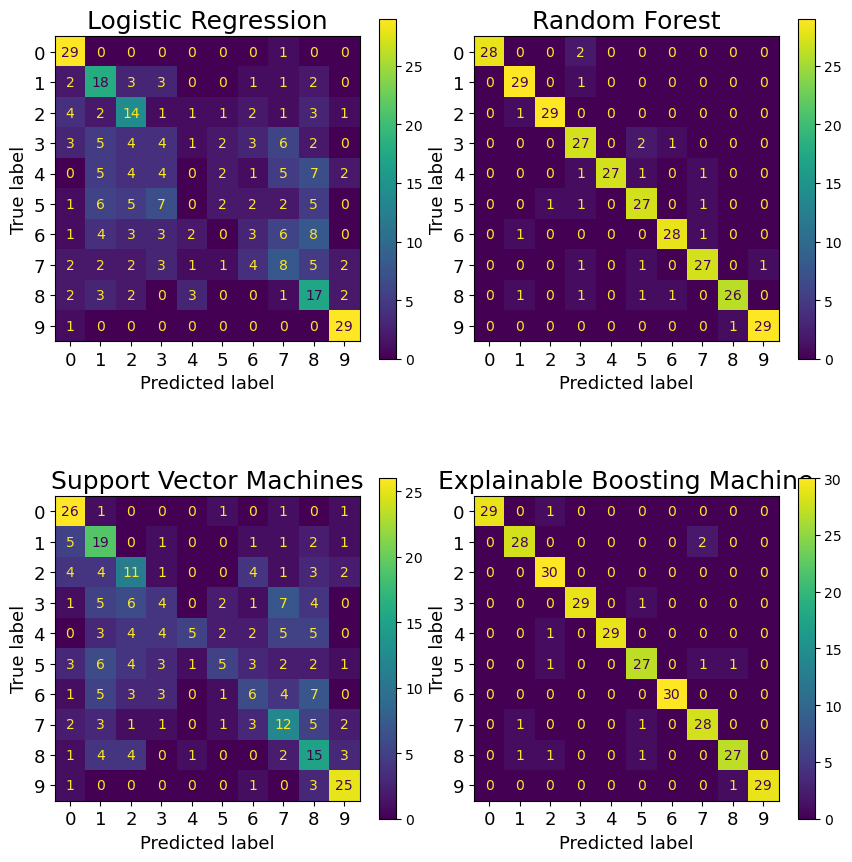

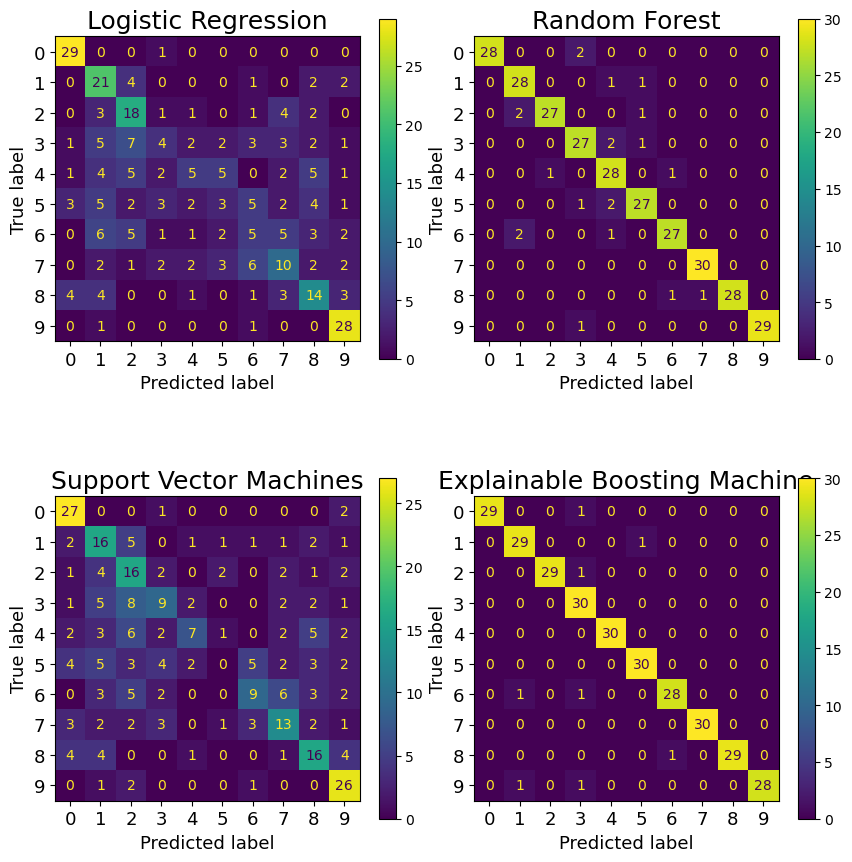

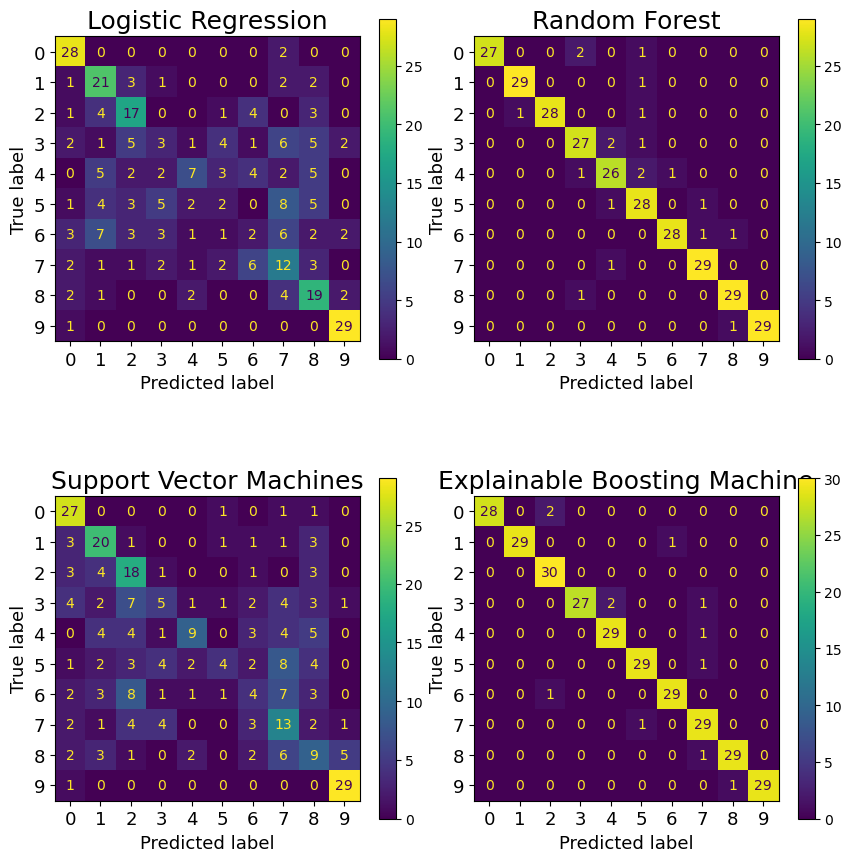

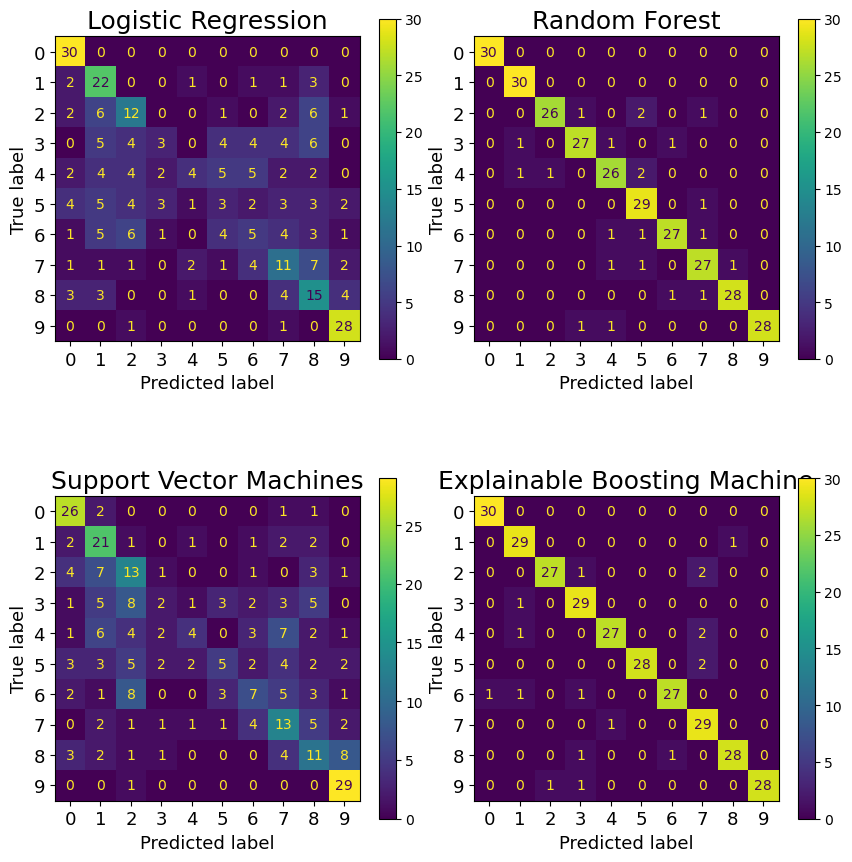

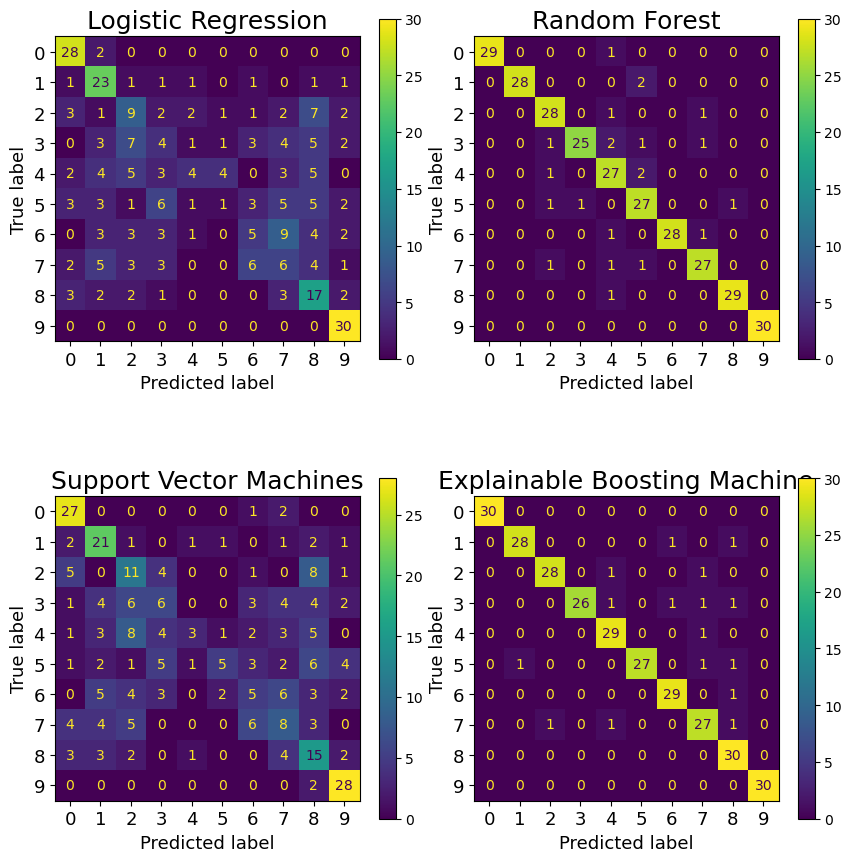

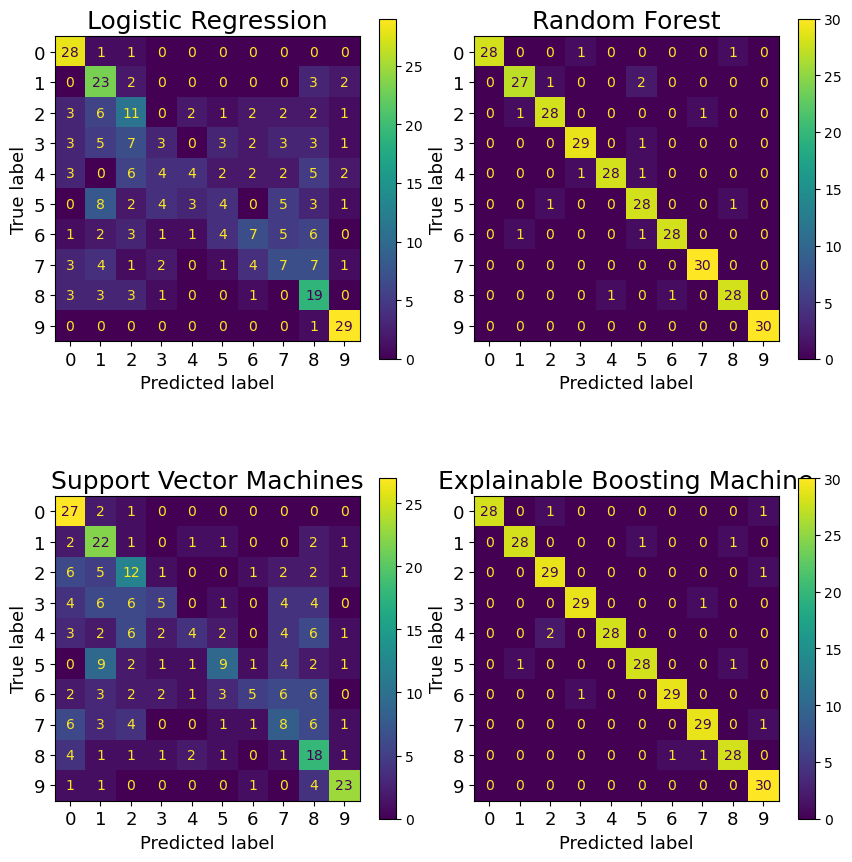

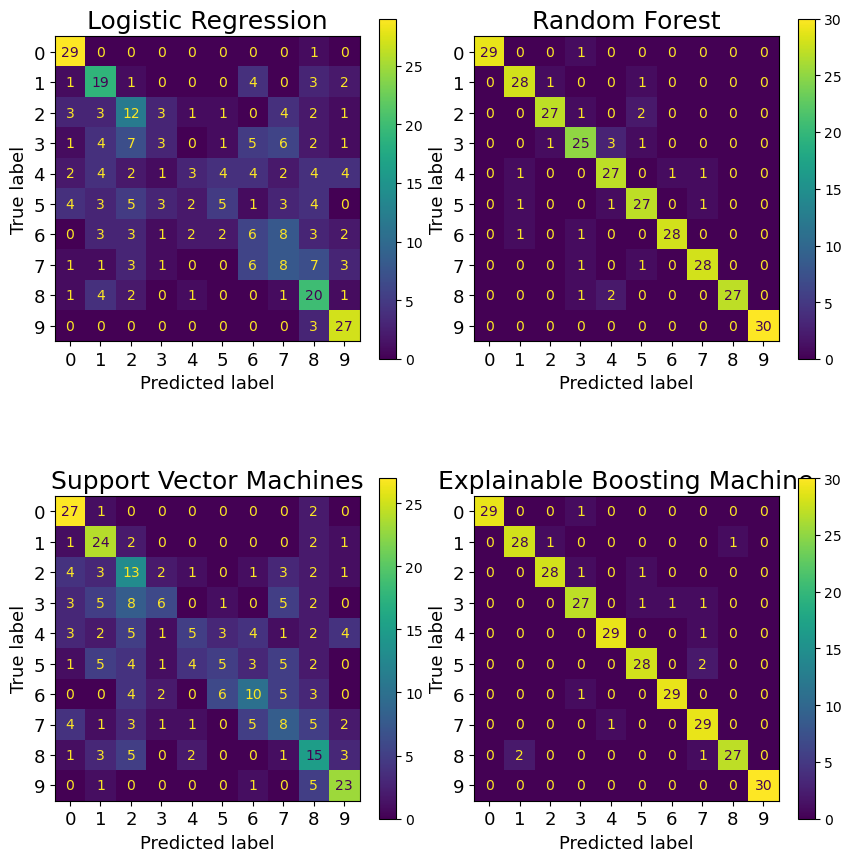

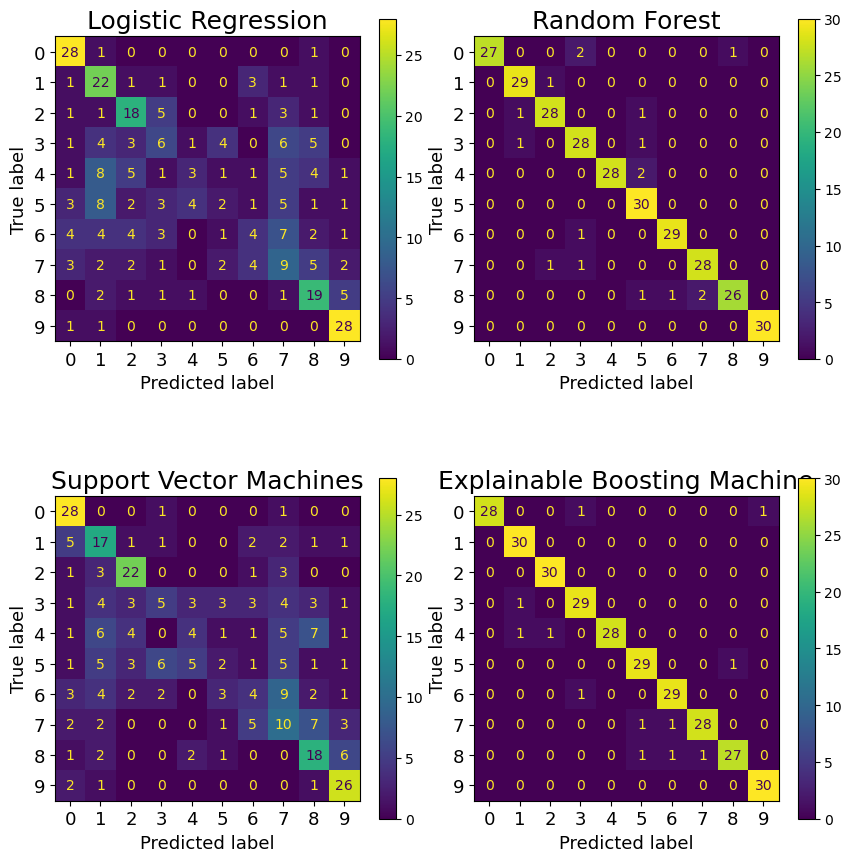

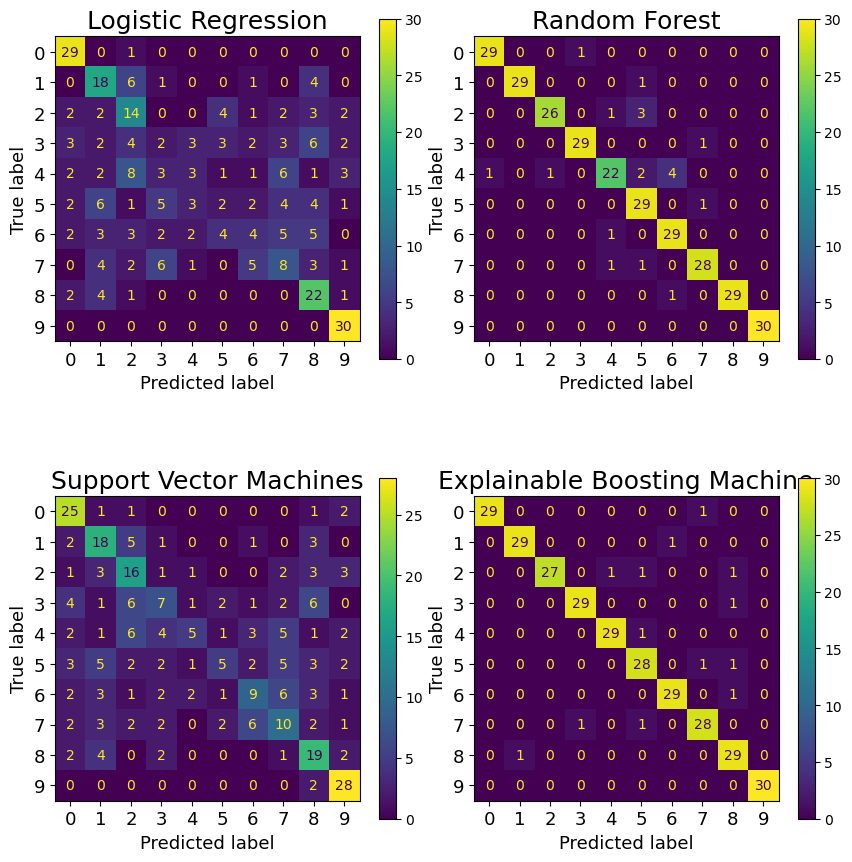

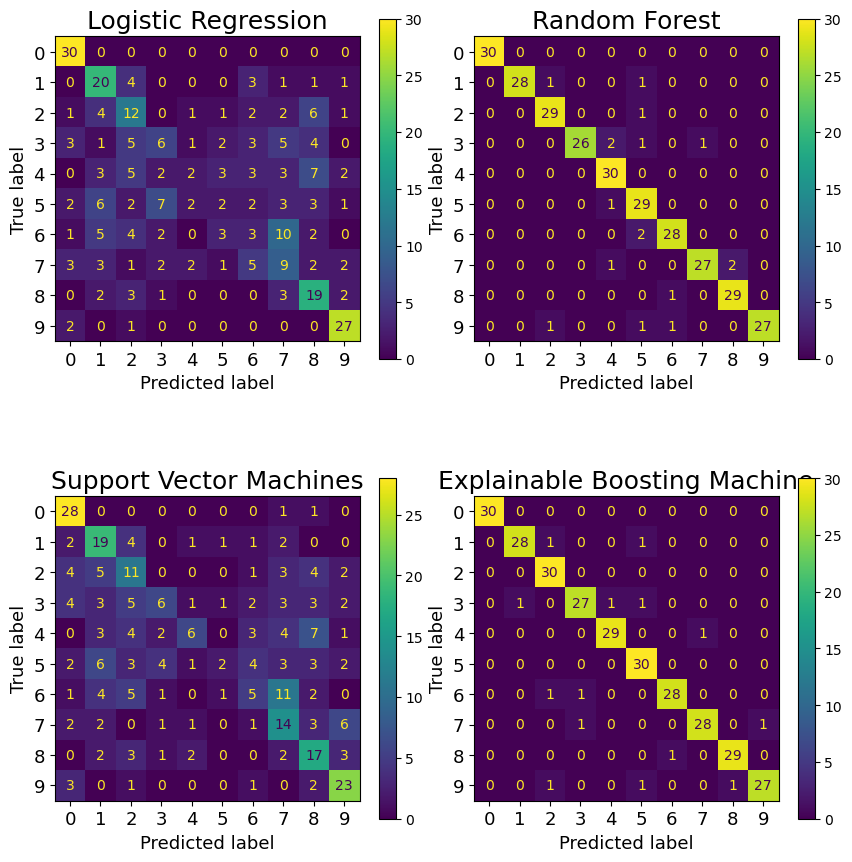

In [61]:
for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    visual.confusion_matrices_pred([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], 
                              [lr_ye, rf_ye, svm_ye, ebm_ye],
                              nrows=2, 
                              ncols=2, 
                              figsize=(8, 8),
                              title_size=title_size,
                              label_size=label_size,
                              titles=["Logistic Regression", "Random Forest", "Support Vector Machines", "Explainable Boosting Machine"]
                              )
    
    plt.savefig(f"{logs_dir}/synth_multi_conf_matrices{i}.png", bbox_inches="tight")
    
    plt.show()

## Curves

In [62]:
# for i in range(sss_nsplits):
#     plt.figure(figsize=(15, 10))
#     
#     lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
#     rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
#     svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
#     ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
#     
#     lr_cm = lr_cms[i]
#     rf_cm = rf_cms[i]
#     svm_cm = svm_cms[i]
#     ebm_cm = ebm_cms[i]
#     
#     lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
#     rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
#     svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
#     ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
#     
#     plt.subplot(1,2,1)
#     perf_analysis.compare_PR([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
#     
#     plt.subplot(1,2,2)
#     perf_analysis.compare_ROC([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
#     
#     plt.savefig(f"{logs_dir}/synth_bin_test_PR_ROC_{i}.png", bbox_inches="tight")
#     
#     plt.show()

## Local Explanations

### LIME

In [63]:
for i in range(sss_nsplits):
    lr_LIME_explanation = lr_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], lr_clfs[i].predict_proba)
    lr_LIME_explanation.show_in_notebook(show_table=True)
    lr_LIME_explanation.save_to_file(f"{logs_dir}/synth_LR_LIME_{i}.html")

In [64]:
for i in range(sss_nsplits):
    rf_LIME_explanation = rf_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], rf_clfs[i].predict_proba)
    rf_LIME_explanation.show_in_notebook(show_table=True)
    rf_LIME_explanation.save_to_file(f"{logs_dir}/synth_RF_LIME_{i}.html")

In [65]:
for i in range(sss_nsplits):
    svm_LIME_explanation = svm_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], svm_clfs[i].predict_proba)
    svm_LIME_explanation.show_in_notebook(show_table=True)
    svm_LIME_explanation.save_to_file(f"{logs_dir}/synth_SVM_LIME_{i}.html")

### SHAP & EBM

In [66]:
# for i in range(sss_nsplits):
#     Exp_inst_pd = X_tests_pd[i].iloc[Exp_index]
#     
#     lr_shap_loc_values = np.array(lr_shaps[i].shap_values(Exp_inst_pd))
#     rf_shap_loc_values = np.array(rf_shaps[i].shap_values(Exp_inst_pd))
#     svm_shap_loc_values = np.array(svm_shaps[i].shap_values(Exp_inst_pd))
#     
#     explanations = [shap.Explanation(lr_shap_loc_values[1, :], lr_shaps[i].expected_value[1], data=Exp_inst_pd),
#                 shap.Explanation(rf_shap_loc_values[1, :], rf_shaps[i].expected_value[1], data=Exp_inst_pd),
#                 shap.Explanation(svm_shap_loc_values[1, :], svm_shaps[i].expected_value[1], data=Exp_inst_pd)]
#     
#     ebm_local = ebm_clfs[i].explain_local(X_tests_pd[i], Y_tests[i])
#     
#     visual.local_shap(explanations, 
#                       ebm_local.data(key=Exp_index),
#                       nrows = 2,
#                       ncols = 2,
#                       figsize = (15,10),
#                       title_size = 22,
#                       label_size = label_size,
#                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
#                       ebm_colors = shap_colors / 255,
#                       num_features=9)
#     
#     plt.savefig(f"{logs_dir}/synth_bin_test_local_SHAP_EBM_{i}.png", bbox_inches="tight")
#     
#     plt.show()


## Global Explanations

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

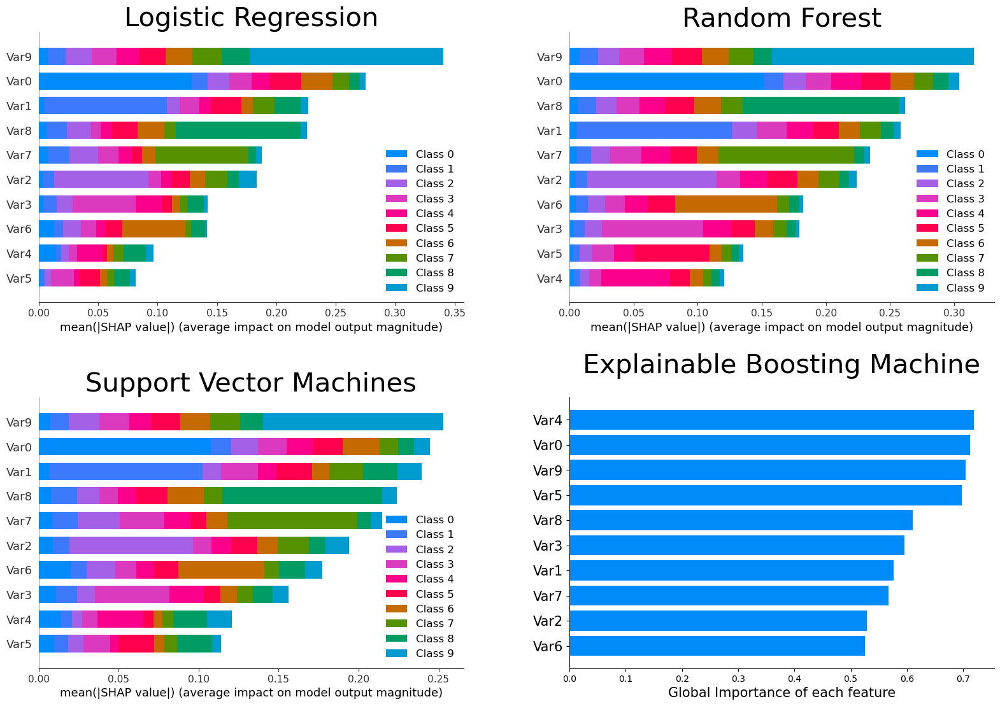

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

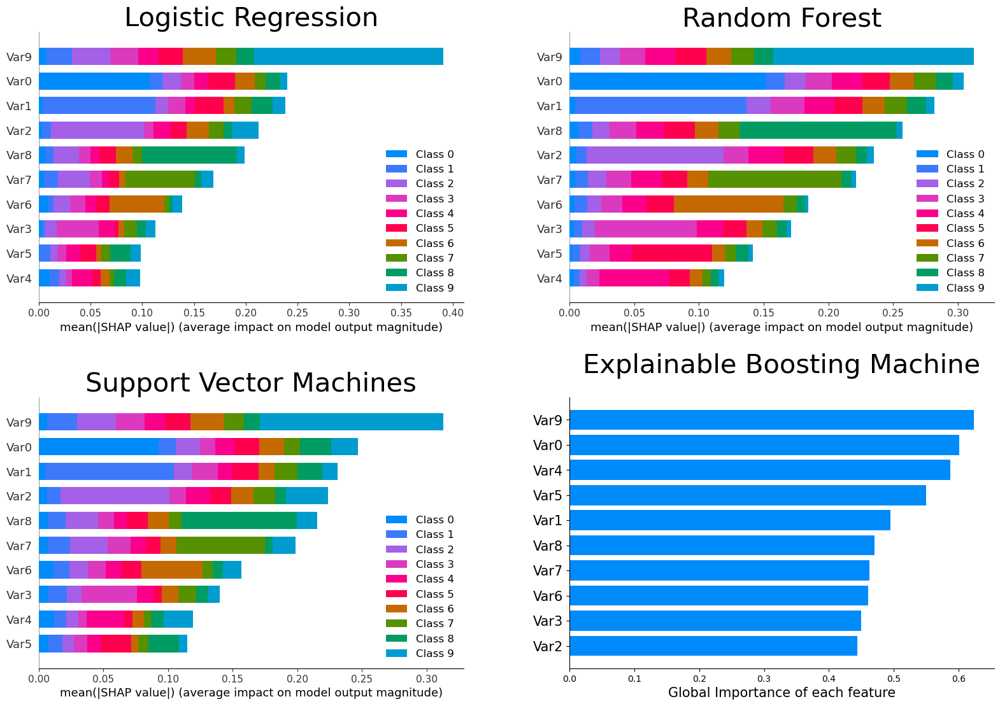

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

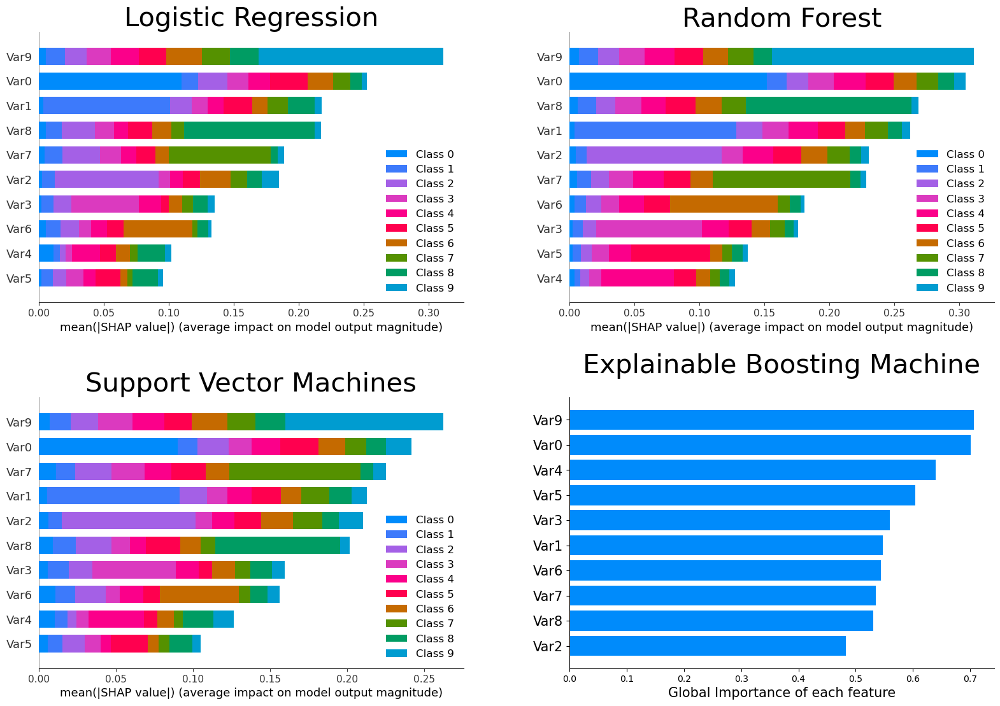

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

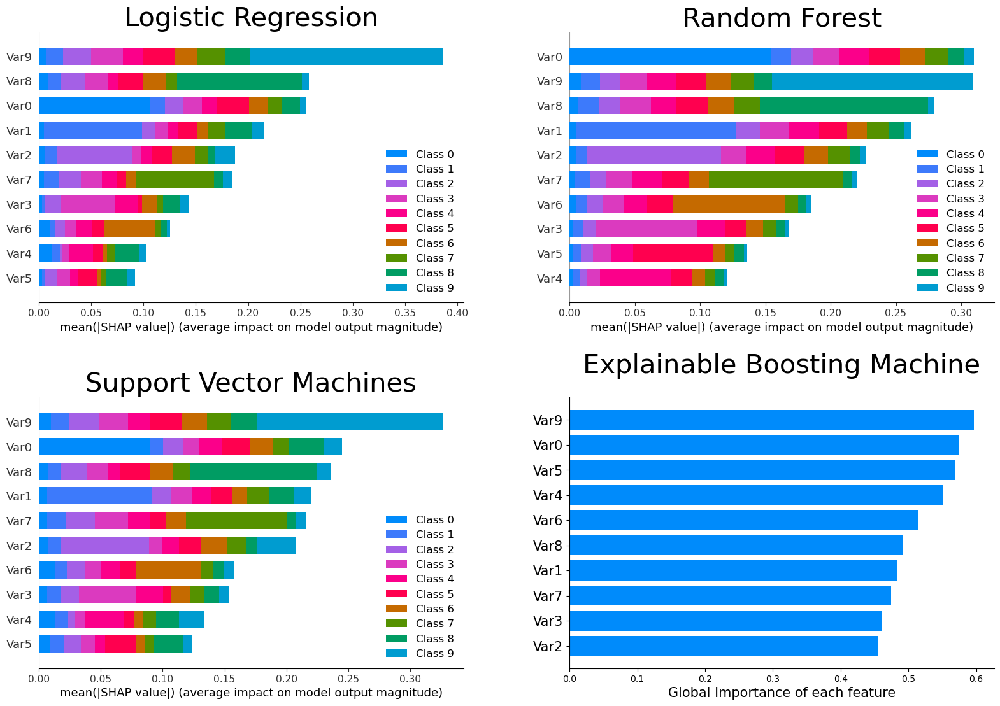

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

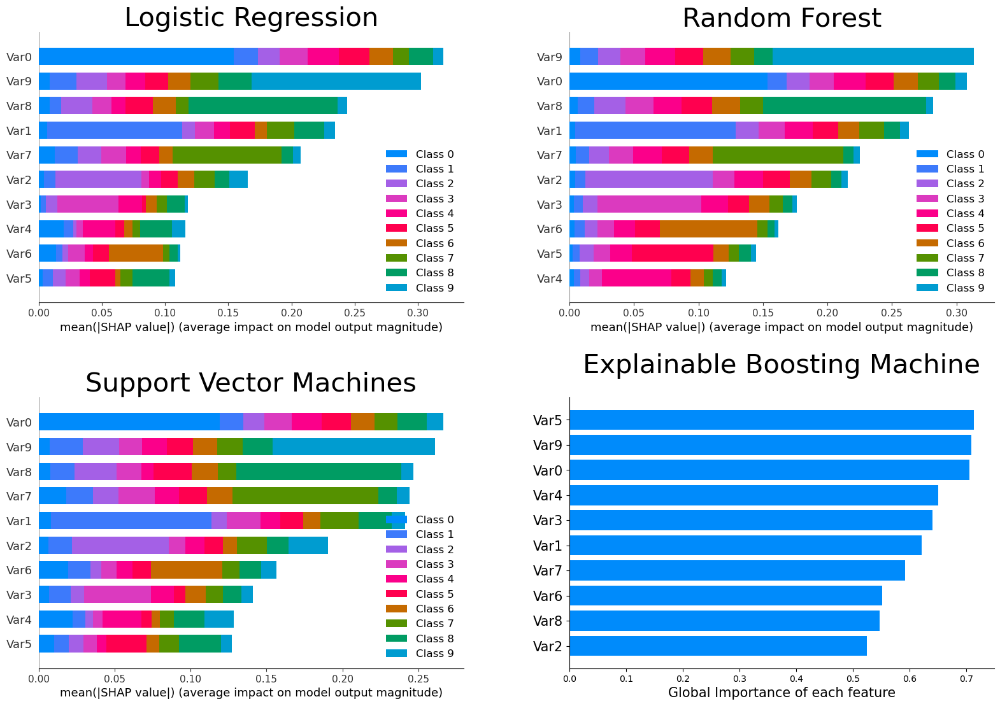

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

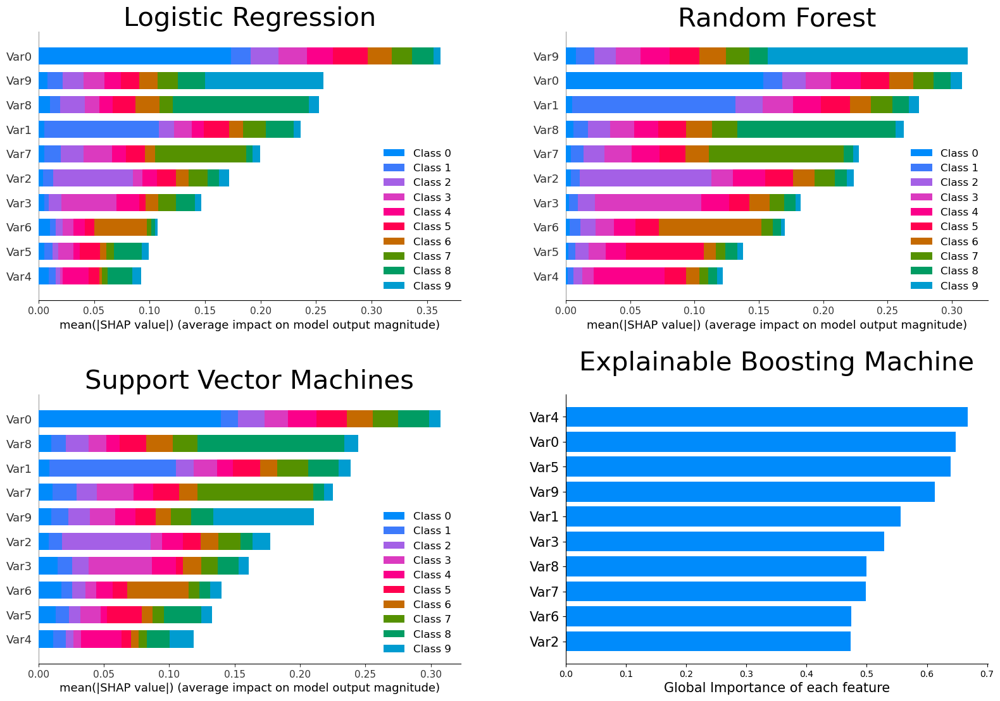

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

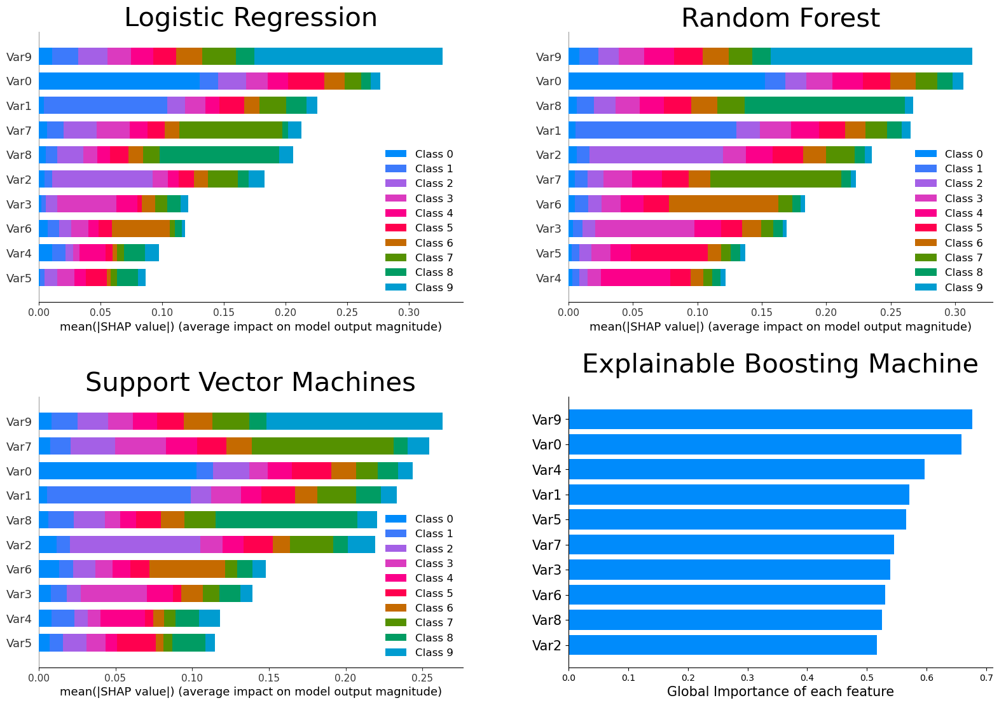

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

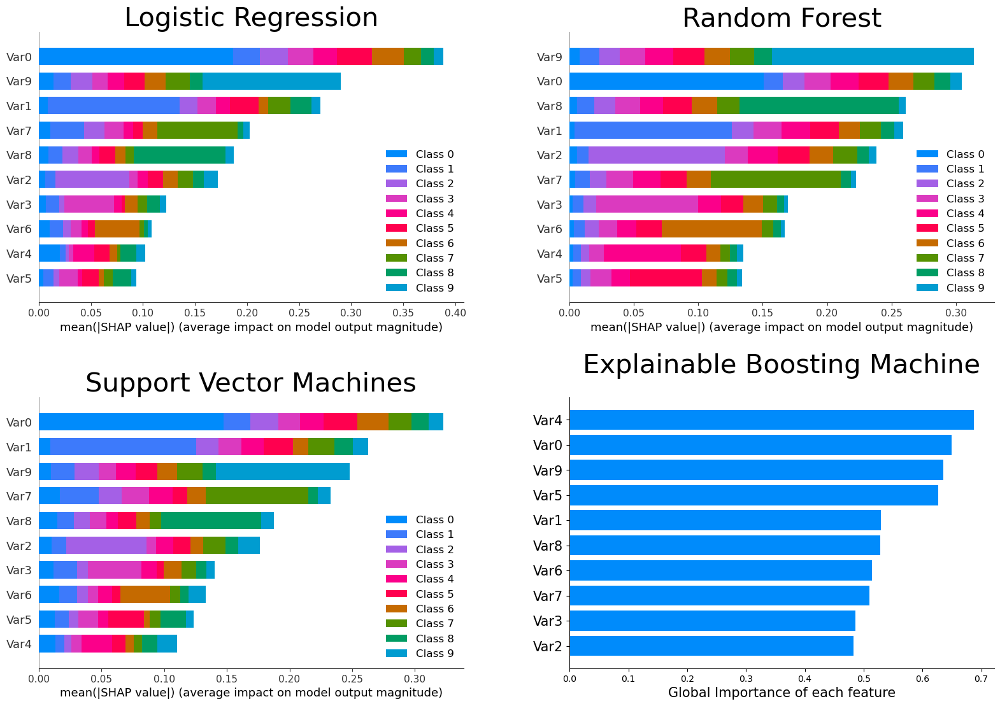

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

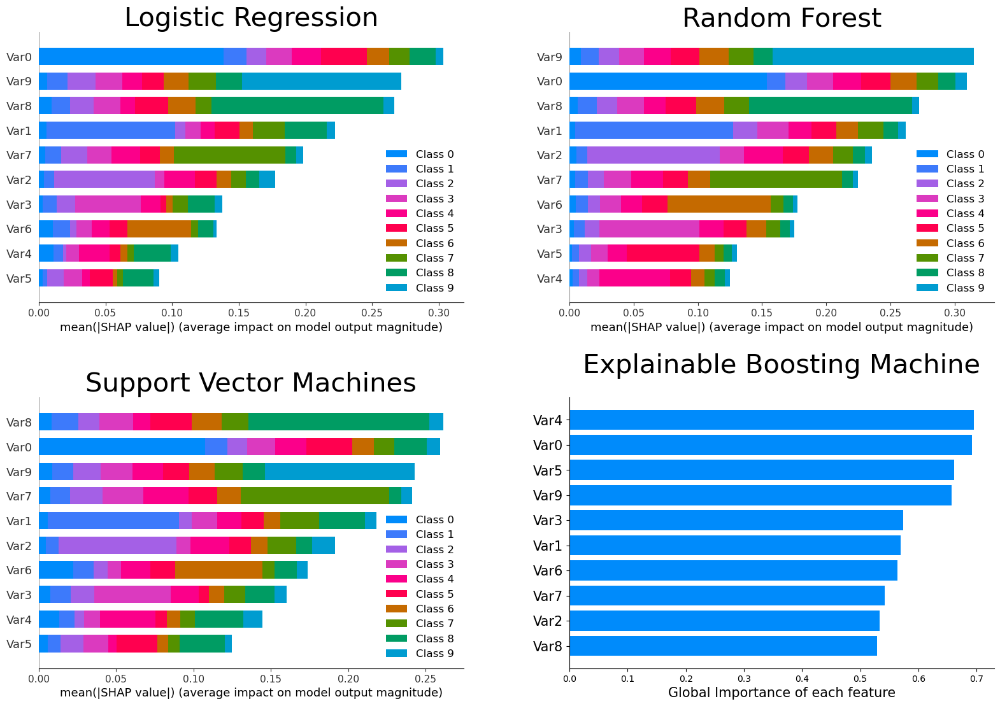

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

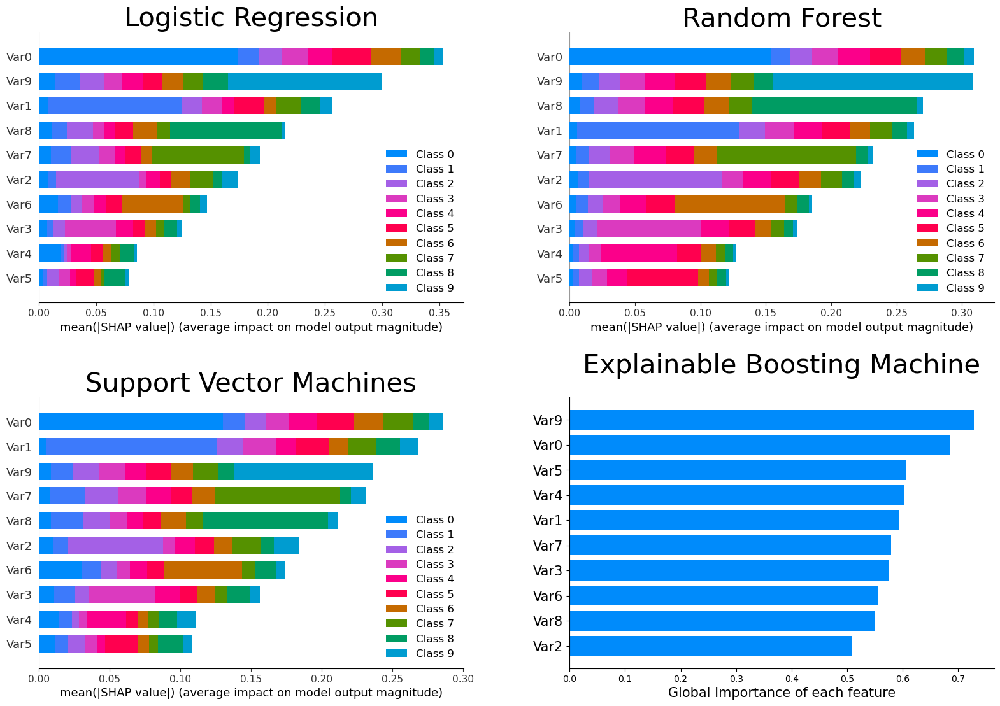

In [67]:
for i in range(sss_nsplits):
    lr_shap_global_values = lr_shaps[i].shap_values(X_tests_pd[i])
    rf_shap_global_values = rf_shaps[i].shap_values(X_tests_pd[i])
    svm_shap_global_values = svm_shaps[i].shap_values(X_tests_pd[i])

    global_shap_values = [lr_shap_global_values,
                      rf_shap_global_values,
                      svm_shap_global_values]

    ebm_global = ebm_clfs[i].explain_global()

    visual.global_shap(global_shap_values,
                       X_tests_pd[i],
                       ebm_global.data(),
                       nrows = 2,
                       ncols = 2,
                       figsize = (15, 10),
                       title_size = 30,
                       label_size = 15,
                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                       ebm_colors = shap_colors/255,
                       num_features=20)

    plt.savefig(f"{logs_dir}/synth_multi_test_global_SHAP_EBM{i}.png", bbox_inches="tight")

    plt.show()